# Sampled Music Detection Based on DTW

**Task**: Given two songs, we tell that one samples from another, what has been taken, and where the sample has been placed.

In [1]:
import os
import sys
import numpy as np
import librosa
from numba import jit
import matplotlib.pyplot as plt
from matplotlib import patches

import libfmp.b
import libfmp.c3
import libfmp.c7

In [2]:
def segment(sig, start=0.0, duration=10.0):
    start = int(start*Fs)
    duration = int(duration*Fs)
    return sig[start: start+duration]

In [3]:
file_1 = "bootylicious.wav"
file_2 = "edgeofseventeen.wav"
data_dir = ""

In [4]:
Fs = 22050
N_feat = 4410
H_feat = 2205

fn1 = os.path.join(data_dir, file_1)
fn2 = os.path.join(data_dir, file_2)

x1, Fs = librosa.load(fn1, sr=Fs)

#x1 = segment(x1, start=8.0, duration=229.0)

x2, Fs = librosa.load(fn2, sr=Fs)
duration = librosa.get_duration(y=x1, sr=Fs)

##This song starts a little later, so i eliminated the initial silence

#x2 = segment(x2, start=5.0, duration=258.0)

In [5]:
import IPython.display as ipd
ipd.Audio(data=x1, rate=Fs)

In [6]:
ipd.Audio(data=x2, rate=Fs)

## Preprocessing
DTW on the time domain:

We split song A into 1-second fragments, and choose the fragment with the least distance to song B

In [7]:
def DTW_cost_matrix(x1_audio, x2_audio, sample_rate, ell=21, d=5):
    N_feat = 4410
    H_feat = 2205
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2_audio, sr=sample_rate, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    return C_FMP

In [8]:
C = DTW_cost_matrix(x1, x2, Fs, ell=24, d=5)

In [9]:
N_feat = 4410
H_feat = 2205
t1 = np.where(C==np.min(C))[0][0]*5*H_feat/Fs
t2 = np.where(C==np.min(C))[1][0]*5*H_feat/Fs
print(t1, t2)

120.5 150.5


## DTW Based Matching: finding the optimal subsequence

- Given two feature sequences, we need to find a subsequence within the longer sequence that optimally fits the shorter one
- We take Chroma features as feature sequences

In [10]:
def DTW_matching(x1, x2, ell=21, d=5):
    # ell: smoothing size
    # d: downsample rate
    C1 = librosa.feature.chroma_stft(y=x1, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat) # 12 chroma bins * time frames with frame size = hopsize / Fs
    C2 = librosa.feature.chroma_stft(y=x2, sr=Fs, tuning=0, norm=None, hop_length=H_feat, n_fft=N_feat)
    
    X, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C1, ell=ell, d=d)
    Y, Fs_cens = libfmp.c7.compute_cens_from_chromagram(C2, ell=ell, d=d)
    N, M = X.shape[1], Y.shape[1]
    
    C_FMP = libfmp.c3.compute_cost_matrix(X, Y, 'euclidean')
    sigma = np.array([[1, 0], [0, 1], [1, 1]])
    D_librosa, P_librosa = librosa.sequence.dtw(C=C_FMP, step_sizes_sigma=sigma, subseq=True, backtrack=True)
    P_librosa = P_librosa[::-1, :]
    
    return D_librosa, P_librosa

In [11]:
def plot_DTW_path(D_librosa, P_librosa):
    # plot
    cmap = libfmp.b.compressed_gray_cmap(alpha=-10, reverse=True)
    fig, ax = plt.subplots(figsize=(15, 5))
    # title='LibROSA implementation with step size condition $\Sigma=\{(1, 0), (0, 1), (1, 1)\}$'
    libfmp.c3.plot_matrix_with_points(D_librosa, P_librosa, ax=[ax], cmap=cmap, 
                                      xlabel=f'Sequence Y ({file_2})', ylabel=f'Sequence X ({file_1})', 
                                      # title=title,
                                      marker='o', linestyle='-')
    ax.set_title("DTW Optimal Warping Path")

In [12]:
ell = 21
d = 5
fragment = segment(x1, t1)
D_librosa, P_librosa = DTW_matching(fragment, x2, ell, d)

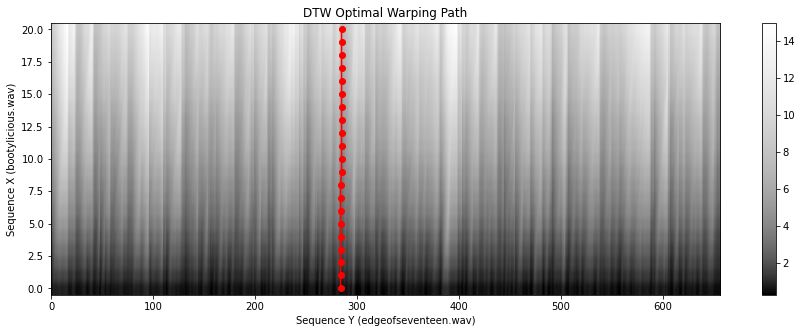

In [13]:
plot_DTW_path(D_librosa, P_librosa)

### DTW Optimal Subsequence

In [14]:
def DTW_subsequence(D_librosa, P_librosa):
    # Subsequence DTW
    N = D_librosa.shape[0]
    Delta_DTW = D_librosa[-1, :] / N # matching function
    a_ast = P_librosa[0, 1]
    b_ast = P_librosa[-1, 1]
    return Delta_DTW, a_ast, b_ast

In [15]:
def plot_DTW_subsequence(Delta_DTW, a_ast, b_ast):
    fig, ax = plt.subplots(figsize=(15, 5))
    libfmp.b.plot_signal(Delta_DTW, ax=ax, xlabel='Time (samples)', ylabel='', ylim=[0, 5],
                         title=r'Matching function $\Delta_\mathrm{DTW}$', color='k')
    ax.set_xlim([-0.5, len(Delta_DTW)-0.5])
    ax.grid()
    ax.plot(b_ast, Delta_DTW[b_ast], 'ro')
    ax.add_patch(patches.Rectangle((a_ast-0.5, 0), b_ast-a_ast+1, 7, facecolor='r', alpha=0.2))

In [16]:
Delta_DTW, a_ast, b_ast = DTW_subsequence(D_librosa, P_librosa)

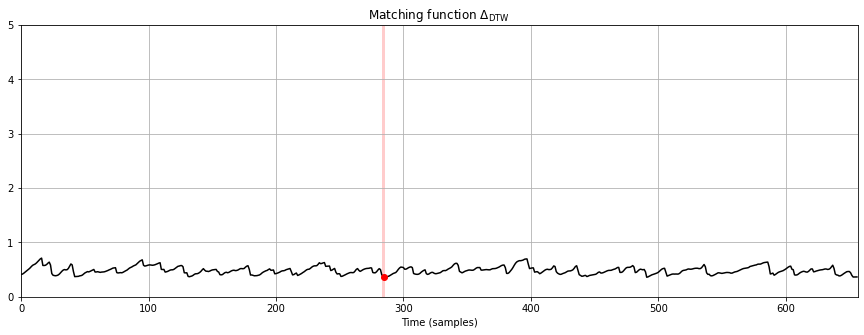

In [17]:
plot_DTW_subsequence(Delta_DTW, a_ast, b_ast)

## Result: Sampled fragment

In [18]:
init_frame = a_ast*d
end_frame = b_ast*d
sample = x2[init_frame*H_feat:end_frame*H_feat]
ipd.Audio(data=sample, rate=Fs)

In [19]:
ipd.Audio(data=fragment, rate=Fs)

# Evaluation

In [ ]:
##This didn't work but i think it is because the songs are way too different